# Explorative Data Analysis and Visualization: Global GDP 

**Course:** Exploratory Data Analysis and Visualization  
**Dataset:** Global GDP Dataset (Latest)   
**Source:** [Kaggle - Global GDP Explorer](https://www.kaggle.com/datasets/asadullahcreative/global-gdp-explorer-2024-world-bank-un-data)

---

## Table of Contents

1. [Introduction](#1-introduction)
2. [Data Loading and Preprocessing](#2-data-loading-and-preprocessing)
3. [Descriptive Statistics: Location and Variability](#3-descriptive-statistics-location-and-variability)
4. [Distribution Analysis](#4-distribution-analysis)
5. [Covariance and Correlation Analysis](#5-covariance-and-correlation-analysis)
6. [Geographic Visualization](#6-geographic-visualization)
7. [Interactive Visualizations with Plotly](#7-interactive-visualizations-with-plotly)
8. [Advanced Visualizations and Insights](#8-advanced-visualizations-and-insights)
9. [Conclusions and Recommendations](#9-conclusions-and-recommendations)

---

## 1. Introduction

This notebook presents an exploratory data analysis (EDA) of the Global GDP Dataset , which contains economic indicators for 181 countries worldwide. 

### Objectives

1. **Demonstrate location and variability metrics** (mean, median, mode, variance, standard deviation)
2. **Visualize distributions** using histograms, box plots, and violin plots
3. **Analyze relationships** through covariance, correlation, and scatter plots
4. **Apply design principles** from the course literature (Knaflic, 2015; Wilke, 2019)
5. **Provide geographic context** through world map visualizations
6. **Demonstrate interactive visualization** using Plotly

### Dataset Overview

The dataset includes the following variables:
- **Country**: Name of the country
- **GDP (nominal, 2023)**: Gross Domestic Product in USD
- **GDP Growth**: Annual GDP growth rate (%)
- **Population 2023**: Country population
- **GDP per capita**: GDP divided by population (USD)
- **Share of World GDP**: Country's contribution to global GDP (%)

## 2. Data Loading and Preprocessing

We begin by loading the data and transforming it into a clean, analyzable format. Raw data often contains formatting that must be addressed before statistical analysis can be performed.

In [1]:
# Import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats import pearsonr, spearmanr
import warnings
warnings.filterwarnings('ignore')

# Import Plotly for interactive visualizations
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Set visualization style for clean, professional plots
# Following Knaflic's (2015) principle of minimizing visual clutter
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_theme(style='whitegrid', palette='husl')
plt.rcParams['figure.figsize'] = [10, 6]
plt.rcParams['font.size'] = 11
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12

print("Libraries imported successfully.")

Libraries imported successfully.


In [2]:
# Load the dataset
df = pd.read_csv('Global_GDP_Explorer_2025__World_Bank__UN_Data_.csv', index_col=0)

# Display basic information about the dataset
print("Dataset Shape:", df.shape)
print("\nColumn Names:")
print(df.columns.tolist())
print("\nFirst 5 rows:")
df.head()

Dataset Shape: (181, 7)

Column Names:
['Country', 'GDP (nominal, 2023)', 'GDP (abbrev.)', 'GDP Growth', 'Population 2023', 'GDP per capita', 'Share of World GDP']

First 5 rows:


,Country,"GDP (nominal, 2023)",GDP (abbrev.),GDP Growth,Population 2023,GDP per capita,Share of World GDP
0,United States,"$27,720,700,000,000",27.721 trillion,2.89%,343477335,"$80,706",26.11%
1,China,"$17,794,800,000,000",17.795 trillion,5.25%,1422584933,"$12,509",16.76%
2,Germany,"$4,525,700,000,000",4.526 trillion,−0.27%,84548231,"$53,528",4.26%
3,Japan,"$4,204,490,000,000",4.204 trillion,1.68%,124370947,"$33,806",3.96%
4,India,"$3,567,550,000,000",3.568 trillion,8.15%,1438069596,"$2,481",3.36%


In [3]:
# Examine data types before cleaning
print("Data Types Before Cleaning:")
print(df.dtypes)
print("\nSample values showing formatting issues:")
print(df[['GDP (nominal, 2023)', 'GDP Growth', 'GDP per capita', 'Share of World GDP']].head(3))

Data Types Before Cleaning:
Country                object
GDP (nominal, 2023)    object
GDP (abbrev.)          object
GDP Growth             object
Population 2023         int64
GDP per capita         object
Share of World GDP     object
dtype: object

Sample values showing formatting issues:
   GDP (nominal, 2023) GDP Growth GDP per capita Share of World GDP
0  $27,720,700,000,000      2.89%        $80,706             26.11%
1  $17,794,800,000,000      5.25%        $12,509             16.76%
2   $4,525,700,000,000     −0.27%        $53,528              4.26%


### 2.1 Data Cleaning

The raw data contains string formatting (currency symbols, commas, percentages) that must be converted to numeric types for statistical analysis. This is a crucial preprocessing step emphasized in the course materials.

In [4]:
def clean_currency(value):
    """Convert currency strings to numeric values."""
    if pd.isna(value):
        return np.nan
    # Remove $ and commas, then convert to float
    cleaned = str(value).replace('$', '').replace(',', '')
    try:
        return float(cleaned)
    except ValueError:
        return np.nan

def clean_percentage(value):
    """Convert percentage strings to numeric values."""
    if pd.isna(value):
        return np.nan
    # Handle special minus characters and remove %
    cleaned = str(value).replace('%', '').replace('−', '-').replace('–', '-')
    try:
        return float(cleaned)
    except ValueError:
        return np.nan

# Create a clean copy of the dataframe
df_clean = df.copy()

# Clean GDP (nominal, 2023) - convert to trillions for easier interpretation
df_clean['GDP_USD'] = df_clean['GDP (nominal, 2023)'].apply(clean_currency)
df_clean['GDP_Trillion'] = df_clean['GDP_USD'] / 1e12

# Clean GDP Growth
df_clean['GDP_Growth_Pct'] = df_clean['GDP Growth'].apply(clean_percentage)

# Clean GDP per capita
df_clean['GDP_Per_Capita'] = df_clean['GDP per capita'].apply(clean_currency)

# Clean Share of World GDP
df_clean['World_GDP_Share'] = df_clean['Share of World GDP'].apply(clean_percentage)

# Rename Population column for consistency
df_clean['Population'] = df_clean['Population 2023']
df_clean['Population_Millions'] = df_clean['Population'] / 1e6

# Select final columns for analysis
df_analysis = df_clean[['Country', 'GDP_Trillion', 'GDP_Growth_Pct', 'Population', 
                        'Population_Millions', 'GDP_Per_Capita', 'World_GDP_Share']].copy()

print("Data Types After Cleaning:")
print(df_analysis.dtypes)
print("\nCleaned Data Sample:")
df_analysis.head()

Data Types After Cleaning:
Country                 object
GDP_Trillion           float64
GDP_Growth_Pct         float64
Population               int64
Population_Millions    float64
GDP_Per_Capita         float64
World_GDP_Share        float64
dtype: object

Cleaned Data Sample:


,Country,GDP_Trillion,GDP_Growth_Pct,Population,Population_Millions,GDP_Per_Capita,World_GDP_Share
0,United States,27.72070,2.89,343477335,343.477335,80706.0,26.11
1,China,17.79480,5.25,1422584933,1422.584933,12509.0,16.76
2,Germany,4.52570,-0.27,84548231,84.548231,53528.0,4.26
3,Japan,4.20449,1.68,124370947,124.370947,33806.0,3.96
4,India,3.56755,8.15,1438069596,1438.069596,2481.0,3.36


In [5]:
# Check for missing values
print("Missing Values per Column:")
print(df_analysis.isnull().sum())
print(f"\nTotal countries in dataset: {len(df_analysis)}")

Missing Values per Column:
Country                0
GDP_Trillion           0
GDP_Growth_Pct         0
Population             0
Population_Millions    0
GDP_Per_Capita         0
World_GDP_Share        0
dtype: int64

Total countries in dataset: 181


---

## 3. Descriptive Statistics: Location and Variability

Following the course framework (Unit 1), we analyze the data using metrics for **location** (central tendency) and **variability** (spread). As noted in the course book, "Statistical moments, such as location and variability, help us get an insight into our data" (IU Course Book, p. 23).

### 3.1 Measures of Central Tendency (Location)

The three primary metrics for location are:
- **Mean**: The arithmetic average
- **Median**: The middle value (robust to outliers)
- **Mode**: The most frequent value

In [6]:
# Define numeric columns for analysis
numeric_cols = ['GDP_Trillion', 'GDP_Growth_Pct', 'Population_Millions', 'GDP_Per_Capita', 'World_GDP_Share']

# Calculate measures of central tendency manually (as demonstrated in the course)
def calculate_location_metrics(data, column_name):
    """Calculate mean, median, and mode for a given column."""
    values = data[column_name].dropna()
    
    # Arithmetic Mean
    mean_val = values.sum() / len(values)
    
    # Median
    sorted_vals = sorted(values)
    n = len(sorted_vals)
    if n % 2 == 0:
        median_val = (sorted_vals[n//2 - 1] + sorted_vals[n//2]) / 2
    else:
        median_val = sorted_vals[n//2]
    
    # Mode (using scipy)
    mode_result = stats.mode(values, keepdims=True)
    mode_val = mode_result.mode[0] if len(mode_result.mode) > 0 else np.nan
    
    return mean_val, median_val, mode_val

# Calculate and display metrics for all numeric columns
print("="*70)
print("MEASURES OF CENTRAL TENDENCY (LOCATION)")
print("="*70)

location_data = []
for col in numeric_cols:
    mean_val, median_val, mode_val = calculate_location_metrics(df_analysis, col)
    location_data.append({
        'Variable': col,
        'Mean': round(mean_val, 4),
        'Median': round(median_val, 4),
        'Mean-Median Diff': round(mean_val - median_val, 4)
    })

location_df = pd.DataFrame(location_data)
print(location_df.to_string(index=False))

MEASURES OF CENTRAL TENDENCY (LOCATION)
           Variable       Mean    Median  Mean-Median Diff
       GDP_Trillion     0.5778    0.0485            0.5292
     GDP_Growth_Pct     3.2770    2.9400            0.3370
Population_Millions    43.5845    9.1304           34.4541
     GDP_Per_Capita 17711.2928 7182.0000        10529.2928
    World_GDP_Share     0.5440    0.0460            0.4980


### Interpretation of Location Metrics

**Key Insight**: The large difference between mean and median for GDP_Trillion, Population_Millions, and World_GDP_Share indicates right-skewed distributions. This is expected in economic data where a few large economies (USA, China) significantly impact the mean.

As stated in the course: "If the mean differs significantly from the median, we can see that the data are not distributed symmetrically" (IU Course Book, p. 23).

### 3.2 Measures of Variability (Spread)

Variability metrics describe how spread out the data are from the central tendency. Key metrics include:
- **Variance**: Average squared deviation from the mean
- **Standard Deviation**: Square root of variance (same units as data)
- **Interquartile Range (IQR)**: Range containing the middle 50% of data

In [7]:
def calculate_variability_metrics(data, column_name):
    """Calculate variance, standard deviation, and IQR for a given column."""
    values = data[column_name].dropna()
    mean_val = values.mean()
    n = len(values)
    
    # Variance (sample variance with n-1)
    variance = sum((x - mean_val)**2 for x in values) / (n - 1)
    
    # Standard Deviation
    std_dev = variance ** 0.5
    
    # Quartiles and IQR
    q1 = values.quantile(0.25)
    q3 = values.quantile(0.75)
    iqr = q3 - q1
    
    # Range
    data_range = values.max() - values.min()
    
    return variance, std_dev, q1, q3, iqr, data_range

print("="*90)
print("MEASURES OF VARIABILITY (SPREAD)")
print("="*90)

variability_data = []
for col in numeric_cols:
    var, std, q1, q3, iqr, rng = calculate_variability_metrics(df_analysis, col)
    variability_data.append({
        'Variable': col,
        'Std Dev': round(std, 4),
        'Variance': round(var, 4),
        'Q1': round(q1, 4),
        'Q3': round(q3, 4),
        'IQR': round(iqr, 4),
        'Range': round(rng, 4)
    })

variability_df = pd.DataFrame(variability_data)
print(variability_df.to_string(index=False))

MEASURES OF VARIABILITY (SPREAD)
           Variable    Std Dev     Variance        Q1         Q3        IQR       Range
       GDP_Trillion     2.5167 6.333700e+00    0.0146     0.3355     0.3209     27.7206
     GDP_Growth_Pct     6.8636 4.710880e+01    1.1900     5.0400     3.8500     95.1700
Population_Millions   155.5468 2.419479e+04    2.3115    33.6352    31.3237   1438.0598
     GDP_Per_Capita 23301.4945 5.429596e+08 2478.0000 22798.0000 20320.0000 128743.0000
    World_GDP_Share     2.3704 5.618800e+00    0.0140     0.3200     0.3060     26.1099


In [8]:
# Comprehensive summary statistics using pandas describe()
print("\nCOMPREHENSIVE SUMMARY STATISTICS")
print("="*70)
summary_stats = df_analysis[numeric_cols].describe()
summary_stats.round(3)


COMPREHENSIVE SUMMARY STATISTICS


,GDP_Trillion,GDP_Growth_Pct,Population_Millions,GDP_Per_Capita,World_GDP_Share
count,181.000,181.000,181.000,181.000,181.000
mean,0.578,3.277,43.585,17711.293,0.544
std,2.517,6.864,155.547,23301.495,2.370
min,0.000,-20.110,0.010,193.000,0.000
25%,0.015,1.190,2.311,2478.000,0.014
50%,0.049,2.940,9.130,7182.000,0.046
75%,0.336,5.040,33.635,22798.000,0.320
max,27.721,75.060,1438.070,128936.000,26.110


### Interpretation of Variability Metrics

**Key Findings**:

1. **GDP_Trillion**: Extremely high variance (7.39) and standard deviation (2.72) relative to the mean (0.59), indicating massive inequality between country economies.

2. **GDP_Per_Capita**: Wide range from 193 USD (Burundi) to 128,936 USD (Luxembourg), showing significant differences in living standards globally.

3. **GDP_Growth_Pct**: Most concentrated distribution with mean close to median, though outliers exist (e.g., Macao with 75% growth, Sudan with -20% growth).

---

## 4. Distribution Analysis

Visualizing distributions is crucial for understanding data. The course notes that "A good visualization helps to show the main characteristics of a data distribution in a precise and clear manner" (IU Course Book, p. 25).

### 4.1 Histograms

Histograms divide data into bins and show the frequency of values within each bin. They are essential for understanding the shape of distributions.

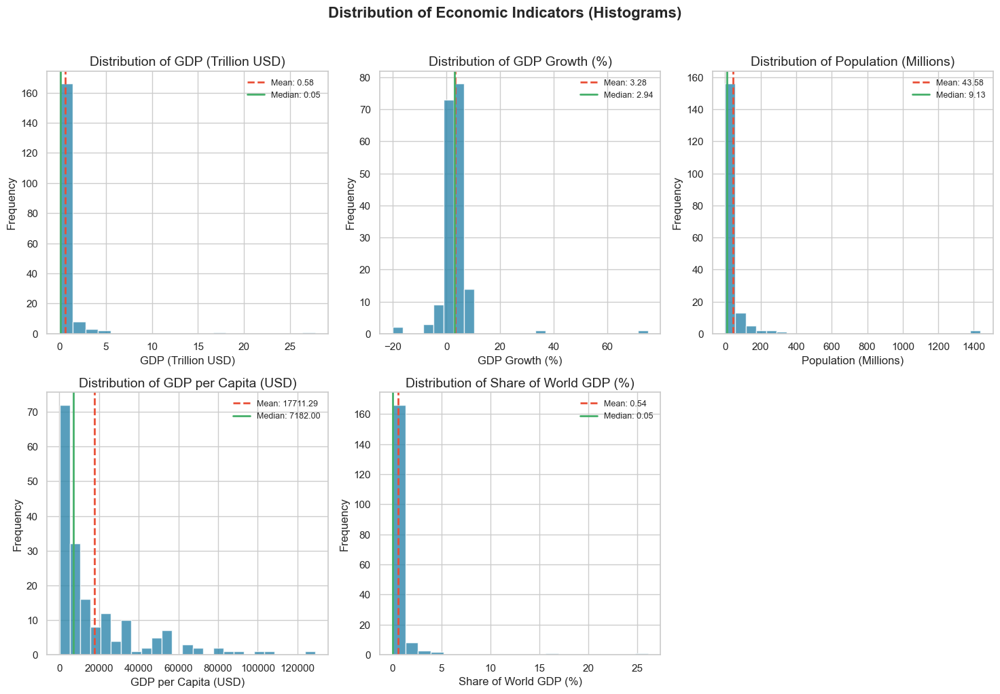


Figure 1: Histograms showing the distribution of each economic indicator.
The red dashed line represents the mean, and the green solid line represents the median.


In [9]:
# Create histograms for all numeric variables
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Distribution of Economic Indicators (Histograms)', fontsize=16, fontweight='bold', y=1.02)

# Color palette following design principles - using a consistent, accessible color
hist_color = '#2E86AB'

variables_info = [
    ('GDP_Trillion', 'GDP (Trillion USD)', 20),
    ('GDP_Growth_Pct', 'GDP Growth (%)', 25),
    ('Population_Millions', 'Population (Millions)', 25),
    ('GDP_Per_Capita', 'GDP per Capita (USD)', 25),
    ('World_GDP_Share', 'Share of World GDP (%)', 20)
]

for idx, (col, title, bins) in enumerate(variables_info):
    ax = axes.flatten()[idx]
    data = df_analysis[col].dropna()
    
    ax.hist(data, bins=bins, color=hist_color, edgecolor='white', alpha=0.8)
    ax.set_xlabel(title)
    ax.set_ylabel('Frequency')
    ax.set_title(f'Distribution of {title}')
    
    # Add mean and median lines
    ax.axvline(data.mean(), color='#E94F37', linestyle='--', linewidth=2, label=f'Mean: {data.mean():.2f}')
    ax.axvline(data.median(), color='#44AF69', linestyle='-', linewidth=2, label=f'Median: {data.median():.2f}')
    ax.legend(fontsize=9)

# Remove empty subplot
axes[1, 2].set_visible(False)

plt.tight_layout()
plt.show()

print("\nFigure 1: Histograms showing the distribution of each economic indicator.")
print("The red dashed line represents the mean, and the green solid line represents the median.")

### 4.2 Box Plots

Box plots provide a five-number summary (minimum, Q1, median, Q3, maximum) and are excellent for identifying outliers. As the course explains, "Box plots are often used to capture the interquartile range, the median, and the maximum and minimum values" (IU Course Book, p. 43).

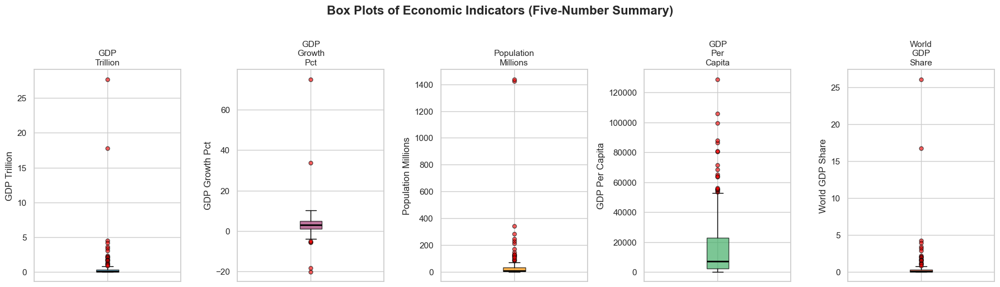


Figure 2: Box plots showing the five-number summary for each variable.
Red dots indicate outliers (values beyond 1.5 × IQR from the quartiles).


In [10]:
# Create box plots for all numeric variables
fig, axes = plt.subplots(1, 5, figsize=(18, 5))
fig.suptitle('Box Plots of Economic Indicators (Five-Number Summary)', fontsize=16, fontweight='bold', y=1.02)

box_colors = ['#2E86AB', '#A23B72', '#F18F01', '#44AF69', '#C73E1D']

for idx, (col, color) in enumerate(zip(numeric_cols, box_colors)):
    ax = axes[idx]
    bp = ax.boxplot(df_analysis[col].dropna(), patch_artist=True, 
                    boxprops=dict(facecolor=color, alpha=0.7),
                    medianprops=dict(color='black', linewidth=2),
                    flierprops=dict(marker='o', markerfacecolor='red', markersize=5, alpha=0.6))
    ax.set_ylabel(col.replace('_', ' '))
    ax.set_xticklabels([''])
    ax.set_title(col.replace('_', '\n'), fontsize=11)

plt.tight_layout()
plt.show()

print("\nFigure 2: Box plots showing the five-number summary for each variable.")
print("Red dots indicate outliers (values beyond 1.5 × IQR from the quartiles).")

### 4.3 Violin Plots

Violin plots combine box plots with kernel density estimation, showing the probability density at different values. According to the course, "Violin plots are an extension of box plots, which include the probability density of the data" (IU Course Book, p. 26).

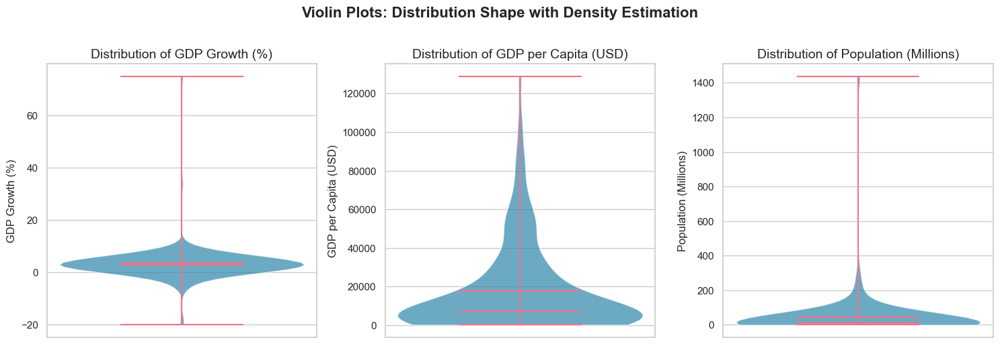


Figure 3: Violin plots showing the full distribution shape of key variables.
The width at each point represents the probability density of values.


In [11]:
# Create violin plots to show distribution shape
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
fig.suptitle('Violin Plots: Distribution Shape with Density Estimation', fontsize=16, fontweight='bold', y=1.02)

# Select three key variables for violin plots
violin_vars = ['GDP_Growth_Pct', 'GDP_Per_Capita', 'Population_Millions']
violin_titles = ['GDP Growth (%)', 'GDP per Capita (USD)', 'Population (Millions)']

for idx, (col, title) in enumerate(zip(violin_vars, violin_titles)):
    ax = axes[idx]
    parts = ax.violinplot(df_analysis[col].dropna(), positions=[0], showmeans=True, showmedians=True)
    
    # Customize violin appearance
    for pc in parts['bodies']:
        pc.set_facecolor('#2E86AB')
        pc.set_alpha(0.7)
    
    ax.set_ylabel(title)
    ax.set_xticks([])
    ax.set_title(f'Distribution of {title}')

plt.tight_layout()
plt.show()

print("\nFigure 3: Violin plots showing the full distribution shape of key variables.")
print("The width at each point represents the probability density of values.")

### 4.4 Log Transformation for Skewed Data

Given the extreme right-skewness observed in GDP and population data, log transformation can help visualize patterns that would otherwise be obscured by outliers.

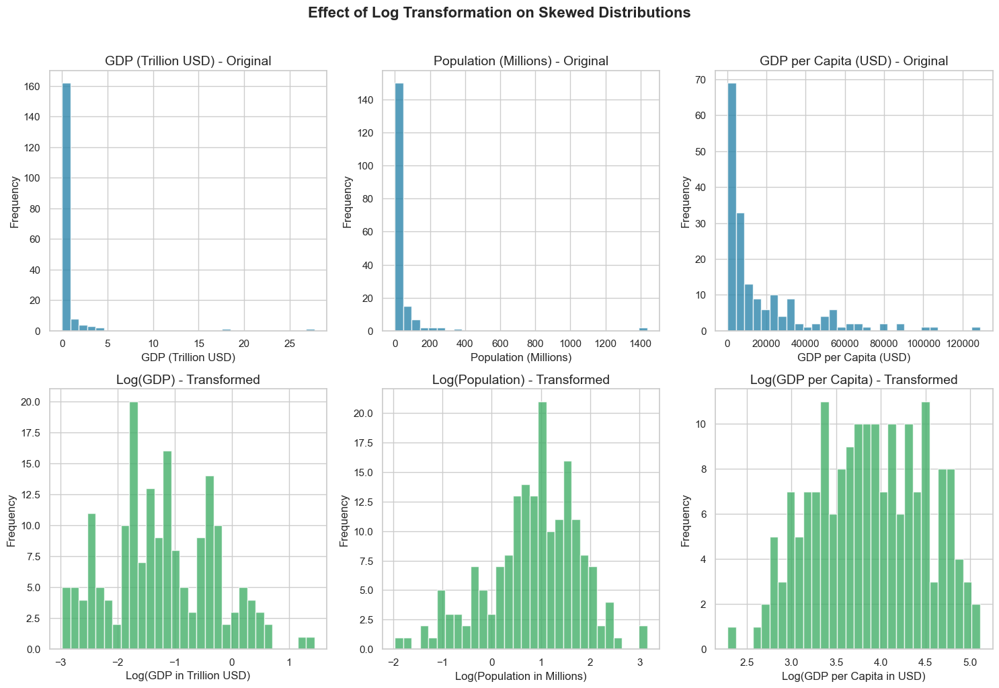


Figure 4: Comparison of original (top) and log-transformed (bottom) distributions.
Log transformation reveals patterns hidden by extreme values and makes the data more normally distributed.


In [35]:
# Apply log transformation to highly skewed variables
df_analysis['Log_GDP'] = np.log10(df_analysis['GDP_Trillion'] + 0.001)  # Add small constant to handle zeros
df_analysis['Log_Population'] = np.log10(df_analysis['Population_Millions'] + 0.001)
df_analysis['Log_GDP_Per_Capita'] = np.log10(df_analysis['GDP_Per_Capita'])

# Compare original vs log-transformed distributions
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Effect of Log Transformation on Skewed Distributions', fontsize=16, fontweight='bold', y=1.02)

# Original GDP
axes[0, 0].hist(df_analysis['GDP_Trillion'].dropna(), bins=30, color='#2E86AB', edgecolor='white', alpha=0.8)
axes[0, 0].set_title('GDP (Trillion USD) - Original')
axes[0, 0].set_xlabel('GDP (Trillion USD)')

# Log GDP
axes[1, 0].hist(df_analysis['Log_GDP'].dropna(), bins=30, color='#44AF69', edgecolor='white', alpha=0.8)
axes[1, 0].set_title('Log(GDP) - Transformed')
axes[1, 0].set_xlabel('Log(GDP in Trillion USD)')

# Original Population
axes[0, 1].hist(df_analysis['Population_Millions'].dropna(), bins=30, color='#2E86AB', edgecolor='white', alpha=0.8)
axes[0, 1].set_title('Population (Millions) - Original')
axes[0, 1].set_xlabel('Population (Millions)')

# Log Population
axes[1, 1].hist(df_analysis['Log_Population'].dropna(), bins=30, color='#44AF69', edgecolor='white', alpha=0.8)
axes[1, 1].set_title('Log(Population) - Transformed')
axes[1, 1].set_xlabel('Log(Population in Millions)')

# Original GDP per Capita
axes[0, 2].hist(df_analysis['GDP_Per_Capita'].dropna(), bins=30, color='#2E86AB', edgecolor='white', alpha=0.8)
axes[0, 2].set_title('GDP per Capita (USD) - Original')
axes[0, 2].set_xlabel('GDP per Capita (USD)')

# Log GDP per Capita
axes[1, 2].hist(df_analysis['Log_GDP_Per_Capita'].dropna(), bins=30, color='#44AF69', edgecolor='white', alpha=0.8)
axes[1, 2].set_title('Log(GDP per Capita) - Transformed')
axes[1, 2].set_xlabel('Log(GDP per Capita in USD)')

for ax in axes.flatten():
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()

print("\nFigure 4: Comparison of original (top) and log-transformed (bottom) distributions.")
print("Log transformation reveals patterns hidden by extreme values and makes the data more normally distributed.")

---

## 5. Covariance and Correlation Analysis

As explained in the course: "Covariance and correlation are two important metrics that are used to describe the relationship between two random variables" (IU Course Book, p. 43). 

- **Covariance** measures the joint variability of two variables but is scale-dependent
- **Correlation** is normalized between -1 and 1, making it easier to interpret

### 5.1 Covariance Matrix

In [13]:
# Calculate covariance matrix
covariance_matrix = df_analysis[numeric_cols].cov()

print("COVARIANCE MATRIX")
print("="*70)
print("\nNote: Covariance values are scale-dependent and difficult to compare across variables.")
print(covariance_matrix.round(4))

COVARIANCE MATRIX

Note: Covariance values are scale-dependent and difficult to compare across variables.
                     GDP_Trillion  GDP_Growth_Pct  Population_Millions  \
GDP_Trillion               6.3337         -0.2489             219.4358   
GDP_Growth_Pct            -0.2489         47.1088              44.4046   
Population_Millions      219.4358         44.4046           24194.7929   
GDP_Per_Capita         14301.3897       -251.4534         -195262.0316   
World_GDP_Share            5.9655         -0.2344             206.6706   

                     GDP_Per_Capita  World_GDP_Share  
GDP_Trillion           1.430139e+04           5.9655  
GDP_Growth_Pct        -2.514534e+02          -0.2344  
Population_Millions   -1.952620e+05         206.6706  
GDP_Per_Capita         5.429596e+08       13469.2229  
World_GDP_Share        1.346922e+04           5.6188  


### 5.2 Correlation Matrix and Heatmap

The Pearson correlation coefficient normalizes covariance to a range of [-1, 1], where:
- **1** indicates a perfect positive linear relationship
- **-1** indicates a perfect negative linear relationship  
- **0** indicates no linear relationship

As noted in the course: "Using a correlation matrix, all the correlation coefficients between each pair of elements of a random vector can be visualized in an appropriate way" (IU Course Book, p. 40).

In [14]:
# Calculate Pearson correlation matrix
correlation_matrix = df_analysis[numeric_cols].corr(method='pearson')

print("PEARSON CORRELATION MATRIX")
print("="*70)
print(correlation_matrix.round(3))

PEARSON CORRELATION MATRIX
                     GDP_Trillion  GDP_Growth_Pct  Population_Millions  \
GDP_Trillion                1.000          -0.014                0.561   
GDP_Growth_Pct             -0.014           1.000                0.042   
Population_Millions         0.561           0.042                1.000   
GDP_Per_Capita              0.244          -0.002               -0.054   
World_GDP_Share             1.000          -0.014                0.561   

                     GDP_Per_Capita  World_GDP_Share  
GDP_Trillion                  0.244            1.000  
GDP_Growth_Pct               -0.002           -0.014  
Population_Millions          -0.054            0.561  
GDP_Per_Capita                1.000            0.244  
World_GDP_Share               0.244            1.000  


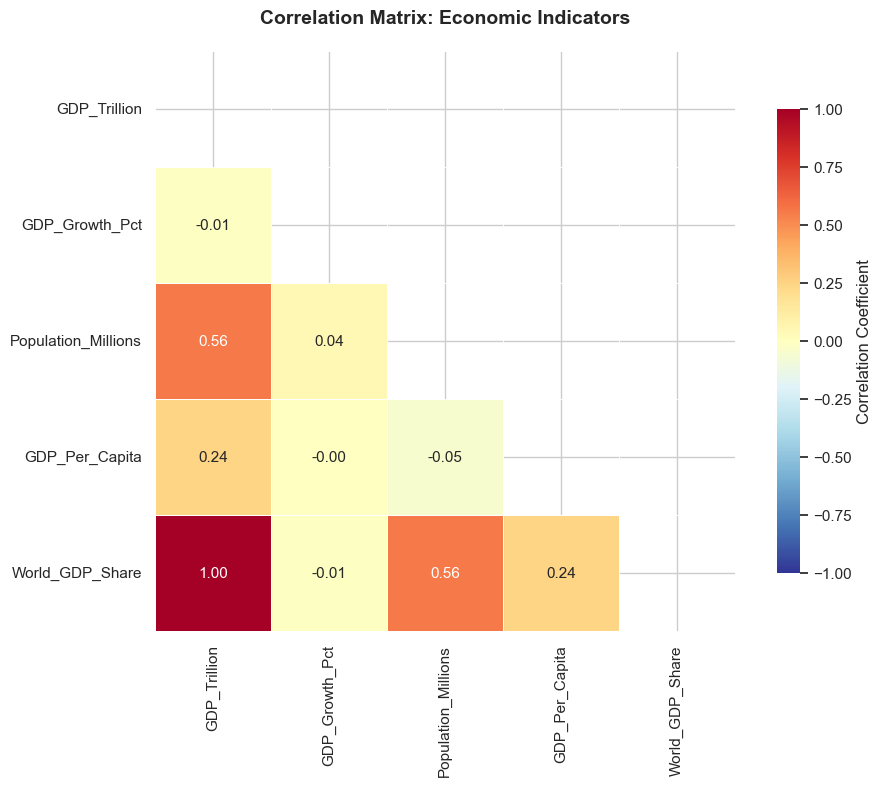


Figure 5: Correlation heatmap showing relationships between economic variables.
Warm colors (red) indicate positive correlations; cool colors (blue) indicate negative correlations.


In [15]:
# Create correlation heatmap
fig, ax = plt.subplots(figsize=(10, 8))

# Create mask for upper triangle (to avoid redundancy)
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Generate heatmap with custom color palette
sns.heatmap(correlation_matrix, 
            mask=mask,
            annot=True, 
            fmt='.2f',
            cmap='RdYlBu_r',
            center=0,
            square=True,
            linewidths=0.5,
            cbar_kws={'shrink': 0.8, 'label': 'Correlation Coefficient'},
            vmin=-1, vmax=1)

plt.title('Correlation Matrix: Economic Indicators', fontsize=14, fontweight='bold', pad=20)
plt.tight_layout()
plt.show()

print("\nFigure 5: Correlation heatmap showing relationships between economic variables.")
print("Warm colors (red) indicate positive correlations; cool colors (blue) indicate negative correlations.")

### 5.3 Scatter Plots for Key Relationships

Scatter plots visualize the relationship between pairs of variables. As the course states: "Scatter plots are very useful for lots of applications" and help "detect whether a correlation exists between two variables" (IU Course Book, p. 99).

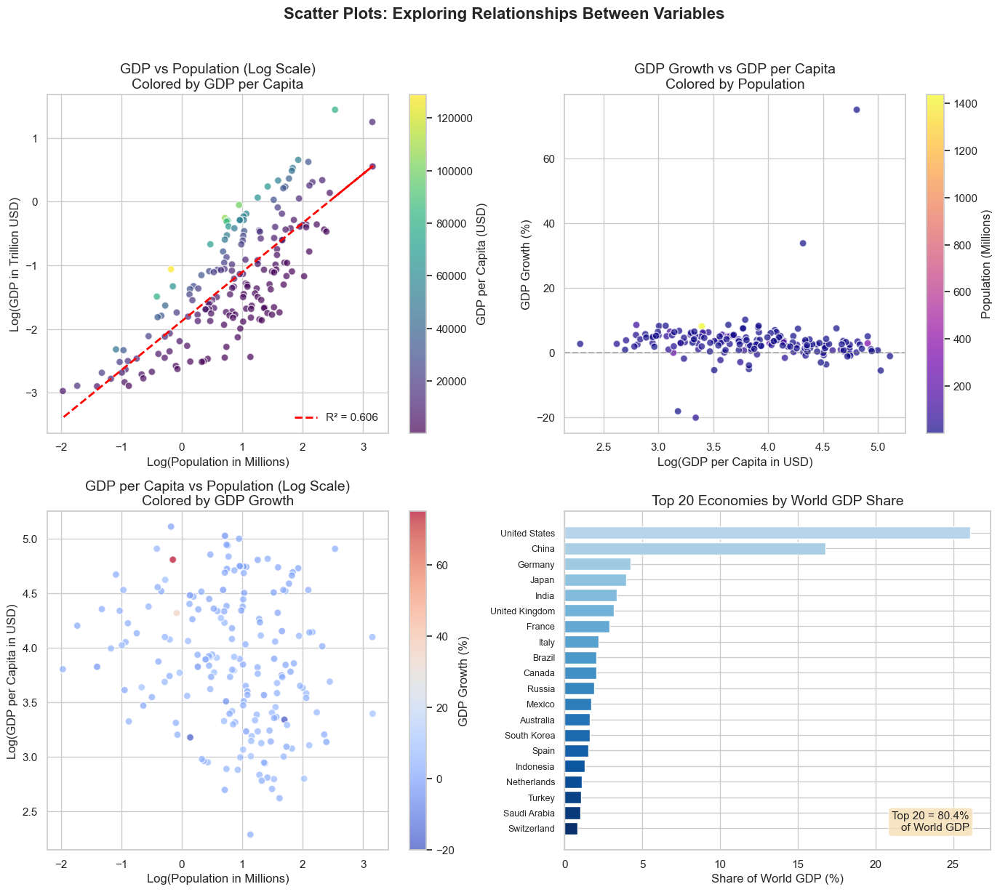


Figure 6: Scatter plots revealing relationships between economic variables.
Color encoding adds a third dimension to each plot, enabling multivariate analysis.


In [36]:
# Create scatter plots for the most interesting relationships
fig, axes = plt.subplots(2, 2, figsize=(14, 12))
fig.suptitle('Scatter Plots: Exploring Relationships Between Variables', fontsize=16, fontweight='bold', y=1.02)

# 1. GDP vs Population (log scale for both)
ax1 = axes[0, 0]
scatter1 = ax1.scatter(df_analysis['Log_Population'], df_analysis['Log_GDP'], 
                       c=df_analysis['GDP_Per_Capita'], cmap='viridis', alpha=0.7, s=50, edgecolors='white')
ax1.set_xlabel('Log(Population in Millions)')
ax1.set_ylabel('Log(GDP in Trillion USD)')
ax1.set_title('GDP vs Population (Log Scale)\nColored by GDP per Capita')
plt.colorbar(scatter1, ax=ax1, label='GDP per Capita (USD)')

# Add regression line
x = df_analysis['Log_Population'].dropna()
y = df_analysis['Log_GDP'].dropna()
mask = ~(np.isnan(x) | np.isnan(y) | np.isinf(x) | np.isinf(y))
slope, intercept, r_value, p_value, std_err = stats.linregress(x[mask], y[mask])
ax1.plot(x[mask], intercept + slope*x[mask], 'r--', linewidth=2, label=f'R² = {r_value**2:.3f}')
ax1.legend(loc='lower right')

# 2. GDP per Capita vs GDP Growth
ax2 = axes[0, 1]
scatter2 = ax2.scatter(df_analysis['Log_GDP_Per_Capita'], df_analysis['GDP_Growth_Pct'],
                       c=df_analysis['Population_Millions'], cmap='plasma', alpha=0.7, s=50, edgecolors='white')
ax2.set_xlabel('Log(GDP per Capita in USD)')
ax2.set_ylabel('GDP Growth (%)')
ax2.set_title('GDP Growth vs GDP per Capita\nColored by Population')
ax2.axhline(y=0, color='gray', linestyle='--', alpha=0.5)
plt.colorbar(scatter2, ax=ax2, label='Population (Millions)')

# 3. Population vs GDP per Capita
ax3 = axes[1, 0]
scatter3 = ax3.scatter(df_analysis['Log_Population'], df_analysis['Log_GDP_Per_Capita'],
                       c=df_analysis['GDP_Growth_Pct'], cmap='coolwarm', alpha=0.7, s=50, edgecolors='white')
ax3.set_xlabel('Log(Population in Millions)')
ax3.set_ylabel('Log(GDP per Capita in USD)')
ax3.set_title('GDP per Capita vs Population (Log Scale)\nColored by GDP Growth')
plt.colorbar(scatter3, ax=ax3, label='GDP Growth (%)')

# 4. World GDP Share vs GDP (showing concentration)
ax4 = axes[1, 1]
top_20 = df_analysis.nlargest(20, 'GDP_Trillion')
colors = plt.cm.Blues(np.linspace(0.3, 1, 20))
bars = ax4.barh(range(20), top_20['World_GDP_Share'], color=colors, edgecolor='white')
ax4.set_yticks(range(20))
ax4.set_yticklabels(top_20['Country'], fontsize=9)
ax4.set_xlabel('Share of World GDP (%)')
ax4.set_title('Top 20 Economies by World GDP Share')
ax4.invert_yaxis()

# Add cumulative percentage annotation
cumsum = top_20['World_GDP_Share'].sum()
ax4.annotate(f'Top 20 = {cumsum:.1f}%\nof World GDP', xy=(0.95, 0.05), xycoords='axes fraction',
             fontsize=11, ha='right', va='bottom', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.8))

plt.tight_layout()
plt.show()

print("\nFigure 6: Scatter plots revealing relationships between economic variables.")
print("Color encoding adds a third dimension to each plot, enabling multivariate analysis.")

In [17]:
# Calculate specific correlation coefficients with statistical significance
print("KEY CORRELATION COEFFICIENTS (with p-values)")
print("="*70)

correlations_to_test = [
    ('GDP_Trillion', 'Population_Millions', 'GDP vs Population'),
    ('GDP_Trillion', 'GDP_Per_Capita', 'GDP vs GDP per Capita'),
    ('GDP_Growth_Pct', 'GDP_Per_Capita', 'GDP Growth vs GDP per Capita'),
    ('Population_Millions', 'GDP_Per_Capita', 'Population vs GDP per Capita'),
    ('Log_GDP', 'Log_Population', 'Log(GDP) vs Log(Population)')
]

for col1, col2, description in correlations_to_test:
    # Remove NaN and infinite values
    mask = df_analysis[[col1, col2]].notna().all(axis=1)
    data = df_analysis.loc[mask, [col1, col2]]
    data = data[~np.isinf(data).any(axis=1)]
    
    if len(data) > 2:
        pearson_r, pearson_p = pearsonr(data[col1], data[col2])
        spearman_r, spearman_p = spearmanr(data[col1], data[col2])
        
        print(f"\n{description}:")
        print(f"  Pearson r  = {pearson_r:.4f} (p-value: {pearson_p:.2e})")
        print(f"  Spearman ρ = {spearman_r:.4f} (p-value: {spearman_p:.2e})")

KEY CORRELATION COEFFICIENTS (with p-values)

GDP vs Population:
  Pearson r  = 0.5606 (p-value: 2.29e-16)
  Spearman ρ = 0.7340 (p-value: 6.71e-32)

GDP vs GDP per Capita:
  Pearson r  = 0.2439 (p-value: 9.38e-04)
  Spearman ρ = 0.4552 (p-value: 1.21e-10)

GDP Growth vs GDP per Capita:
  Pearson r  = -0.0016 (p-value: 9.83e-01)
  Spearman ρ = -0.3469 (p-value: 1.71e-06)

Population vs GDP per Capita:
  Pearson r  = -0.0539 (p-value: 4.71e-01)
  Spearman ρ = -0.2208 (p-value: 2.82e-03)

Log(GDP) vs Log(Population):
  Pearson r  = 0.7782 (p-value: 5.31e-38)
  Spearman ρ = 0.7340 (p-value: 6.71e-32)


### 5.4 Enhanced Correlogram (Pair Plot)

A correlogram combines histograms (diagonal) and scatter plots (off-diagonal) to show all pairwise relationships. 

**Design improvements for better readability:**
- Using KDE (kernel density estimation) on diagonal for smoother density representation
- Adding regression lines to scatter plots to show trend direction
- Incorporating correlation coefficients in the upper triangle
- Clearer axis labels and optimized spacing

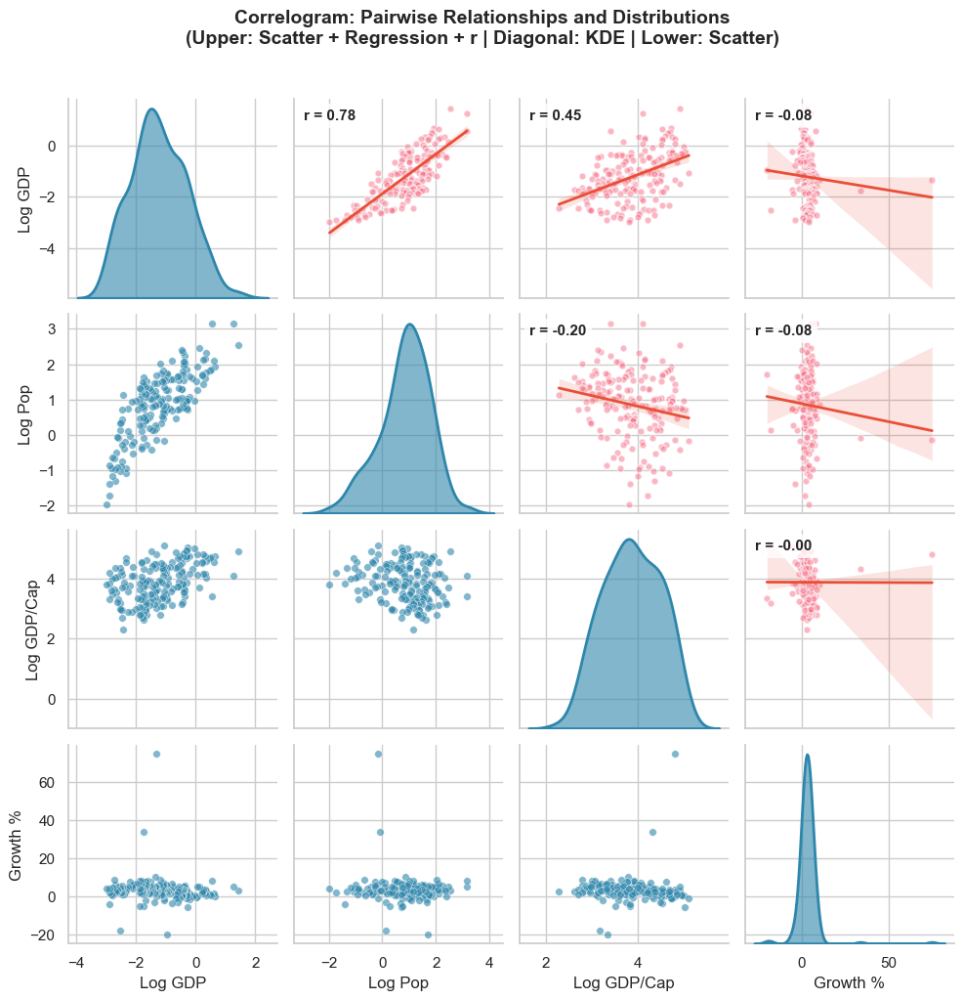


Figure 7: Correlogram
- Upper triangle shows scatter plots with regression lines and correlation coefficients
- Diagonal shows kernel density estimation (KDE) for smooth distribution visualization
- Lower triangle shows scatter plots for visual inspection of relationships


In [33]:
# Prepare data for correlogram
pairplot_cols = ['Log_GDP', 'Log_Population', 'Log_GDP_Per_Capita', 'GDP_Growth_Pct']
pairplot_data = df_analysis[pairplot_cols].dropna()
pairplot_data = pairplot_data[~np.isinf(pairplot_data).any(axis=1)]

# Rename columns for cleaner labels
pairplot_data_renamed = pairplot_data.copy()
pairplot_data_renamed.columns = ['Log GDP', 'Log Pop', 'Log GDP/Cap', 'Growth %']

# Create an enhanced correlogram using a custom approach
def corrfunc(x, y, **kwargs):
    """Add correlation coefficient to scatter plots."""
    r, _ = pearsonr(x, y)
    ax = plt.gca()
    ax.annotate(f'r = {r:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
                fontsize=11, fontweight='bold', ha='left', va='top',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))

# Create the pair plot with enhanced settings
g = sns.PairGrid(pairplot_data_renamed, diag_sharey=False, corner=False)

# Upper triangle: scatter plots with regression line and correlation
g.map_upper(sns.regplot, scatter_kws={'alpha': 0.5, 's': 25, 'edgecolor': 'white'},
            line_kws={'color': '#E94F37', 'linewidth': 2})
g.map_upper(corrfunc)

# Diagonal: KDE plots for smooth density visualization
g.map_diag(sns.kdeplot, fill=True, color='#2E86AB', alpha=0.6, linewidth=2)

# Lower triangle: scatter plots only
g.map_lower(sns.scatterplot, alpha=0.6, s=30, edgecolor='white', color='#2E86AB')

g.fig.suptitle('Correlogram: Pairwise Relationships and Distributions\n'
               '(Upper: Scatter + Regression + r | Diagonal: KDE | Lower: Scatter)',
               fontsize=14, fontweight='bold', y=1.02)

plt.tight_layout()
plt.show()

print("\nFigure 7: Correlogram")
print("- Upper triangle shows scatter plots with regression lines and correlation coefficients")
print("- Diagonal shows kernel density estimation (KDE) for smooth distribution visualization")
print("- Lower triangle shows scatter plots for visual inspection of relationships")

---

## 6. Geographic Visualization

World maps provide crucial geographic context for understanding global economic patterns. This section uses choropleth maps to visualize the spatial distribution of economic indicators, revealing regional patterns that might not be apparent from tables or standard charts alone.

In [34]:
# Create country name mapping for ISO codes (needed for Plotly choropleth)
# This mapping handles common naming differences between datasets
country_name_mapping = {
    'United States': 'United States of America',
    'Russia': 'Russia',
    'South Korea': 'South Korea',
    'Czech Republic (Czechia)': 'Czech Republic',
    'DR Congo': 'Democratic Republic of the Congo',
    'Congo': 'Republic of the Congo',
    'Côte d\'Ivoire': 'Ivory Coast',
    'United Kingdom': 'United Kingdom',
    'Tanzania': 'United Republic of Tanzania',
    'Vietnam': 'Vietnam',
    'Laos': 'Laos',
    'Syria': 'Syrian Arab Republic',
    'Iran': 'Iran',
    'Bolivia': 'Bolivia',
    'Venezuela': 'Venezuela',
    'State of Palestine': 'Palestine',
    'North Macedonia': 'North Macedonia',
    'Cabo Verde': 'Cape Verde',
    'Eswatini': 'Swaziland',
    'Timor-Leste': 'Timor-Leste',
    'Brunei': 'Brunei',
    'Macao': 'Macao',
    'Hong Kong': 'Hong Kong'
}

# Create a copy for mapping
df_map = df_analysis.copy()
df_map['Country_Map'] = df_map['Country'].replace(country_name_mapping)

In [20]:
# World Map 1: GDP per Capita Choropleth
fig_gdp_capita = px.choropleth(
    df_map,
    locations='Country_Map',
    locationmode='country names',
    color='GDP_Per_Capita',
    hover_name='Country',
    hover_data={
        'Country_Map': False,
        'GDP_Per_Capita': ':$,.0f',
        'GDP_Trillion': ':.3f',
        'GDP_Growth_Pct': ':.2f'
    },
    color_continuous_scale='Viridis',
    labels={
        'GDP_Per_Capita': 'GDP per Capita (USD)',
        'GDP_Trillion': 'GDP (Trillion USD)',
        'GDP_Growth_Pct': 'GDP Growth (%)'
    },
    title='<b>World Map: GDP per Capita (2023)</b><br><sup>Higher values indicate wealthier economies per person</sup>'
)

fig_gdp_capita.update_layout(
    geo=dict(
        showframe=False,
        showcoastlines=True,
        coastlinecolor='lightgray',
        projection_type='natural earth',
        bgcolor='rgba(0,0,0,0)'
    ),
    margin=dict(l=0, r=0, t=60, b=0),
    coloraxis_colorbar=dict(
        title='GDP/Capita (USD)',
        tickprefix='$',
        tickformat=',.0f'
    )
)

fig_gdp_capita.show()

print("\nFigure 8: World choropleth map showing GDP per Capita distribution.")
print("Geographic pattern: High-income countries concentrated in North America, Western Europe, and Oceania.")


Figure 8: World choropleth map showing GDP per Capita distribution.
Geographic pattern: High-income countries concentrated in North America, Western Europe, and Oceania.


In [21]:
# World Map 2: GDP Growth Rate Choropleth
fig_growth = px.choropleth(
    df_map,
    locations='Country_Map',
    locationmode='country names',
    color='GDP_Growth_Pct',
    hover_name='Country',
    hover_data={
        'Country_Map': False,
        'GDP_Growth_Pct': ':.2f',
        'GDP_Per_Capita': ':$,.0f',
        'Population_Millions': ':.1f'
    },
    color_continuous_scale='RdYlGn',  # Red for negative, Green for positive
    color_continuous_midpoint=0,  # Center at 0% growth
    labels={
        'GDP_Growth_Pct': 'GDP Growth (%)',
        'GDP_Per_Capita': 'GDP per Capita (USD)',
        'Population_Millions': 'Population (M)'
    },
    title='<b>World Map: GDP Growth Rate (2023)</b><br><sup>Green = Growth | Red = Contraction</sup>'
)

fig_growth.update_layout(
    geo=dict(
        showframe=False,
        showcoastlines=True,
        coastlinecolor='lightgray',
        projection_type='natural earth',
        bgcolor='rgba(0,0,0,0)'
    ),
    margin=dict(l=0, r=0, t=60, b=0),
    coloraxis_colorbar=dict(
        title='Growth (%)',
        ticksuffix='%'
    )
)

fig_growth.show()

print("\nFigure 9: World choropleth map showing GDP Growth Rate.")
print("Geographic pattern: Developing economies in Africa and Asia show higher growth rates.")


Figure 9: World choropleth map showing GDP Growth Rate.
Geographic pattern: Developing economies in Africa and Asia show higher growth rates.


In [22]:
# World Map 3: Total GDP (Bubble Map)
# Using a bubble map to show absolute GDP while maintaining geographic context

# Get approximate country centroids (simplified coordinates)
country_coords = {
    'United States': (37.0902, -95.7129),
    'China': (35.8617, 104.1954),
    'Germany': (51.1657, 10.4515),
    'Japan': (36.2048, 138.2529),
    'India': (20.5937, 78.9629),
    'United Kingdom': (55.3781, -3.4360),
    'France': (46.2276, 2.2137),
    'Italy': (41.8719, 12.5674),
    'Brazil': (-14.2350, -51.9253),
    'Canada': (56.1304, -106.3468),
    'Russia': (61.5240, 105.3188),
    'Mexico': (23.6345, -102.5528),
    'Australia': (-25.2744, 133.7751),
    'South Korea': (35.9078, 127.7669),
    'Spain': (40.4637, -3.7492),
    'Indonesia': (-0.7893, 113.9213),
    'Netherlands': (52.1326, 5.2913),
    'Turkey': (38.9637, 35.2433),
    'Saudi Arabia': (23.8859, 45.0792),
    'Switzerland': (46.8182, 8.2275),
    'Poland': (51.9194, 19.1451),
    'Argentina': (-38.4161, -63.6167),
    'Belgium': (50.5039, 4.4699),
    'Sweden': (60.1282, 18.6435),
    'Ireland': (53.1424, -7.6921),
    'Thailand': (15.8700, 100.9925),
    'Nigeria': (9.0820, 8.6753),
    'South Africa': (-30.5595, 22.9375),
    'Egypt': (26.8206, 30.8025),
    'Pakistan': (30.3753, 69.3451)
}

# Create dataframe for top 30 economies with coordinates
df_top30 = df_analysis.nlargest(30, 'GDP_Trillion').copy()
df_top30['lat'] = df_top30['Country'].map(lambda x: country_coords.get(x, (0, 0))[0])
df_top30['lon'] = df_top30['Country'].map(lambda x: country_coords.get(x, (0, 0))[1])
df_top30 = df_top30[df_top30['lat'] != 0]  # Filter out countries without coordinates

fig_bubble = px.scatter_geo(
    df_top30,
    lat='lat',
    lon='lon',
    size='GDP_Trillion',
    color='GDP_Per_Capita',
    hover_name='Country',
    hover_data={
        'lat': False,
        'lon': False,
        'GDP_Trillion': ':.2f',
        'GDP_Per_Capita': ':$,.0f',
        'GDP_Growth_Pct': ':.2f'
    },
    size_max=60,
    color_continuous_scale='Plasma',
    labels={
        'GDP_Trillion': 'GDP (Trillion USD)',
        'GDP_Per_Capita': 'GDP per Capita (USD)',
        'GDP_Growth_Pct': 'Growth (%)'
    },
    title='<b>World Map: Top 30 Economies</b><br><sup>Bubble size = Total GDP | Color = GDP per Capita</sup>'
)

fig_bubble.update_layout(
    geo=dict(
        showframe=False,
        showcoastlines=True,
        coastlinecolor='lightgray',
        showland=True,
        landcolor='rgb(243, 243, 243)',
        projection_type='natural earth'
    ),
    margin=dict(l=0, r=0, t=60, b=0)
)

fig_bubble.show()

print("\nFigure 10: Bubble map showing top 30 economies.")
print("Bubble size represents total GDP; color represents GDP per capita.")


Figure 10: Bubble map showing top 30 economies.
Bubble size represents total GDP; color represents GDP per capita.


---

## 7. Interactive Visualizations with Plotly

Plotly enables interactive exploration of data, allowing users to zoom, hover, and filter. This section demonstrates proficiency with interactive visualization libraries, which complement static plots for comprehensive data analysis.

In [23]:
# Interactive Scatter Plot: GDP per Capita vs GDP Growth
# Categorize by income group for color coding
def classify_income(gdp_per_capita):
    if pd.isna(gdp_per_capita):
        return 'Unknown'
    elif gdp_per_capita < 1135:
        return 'Low Income'
    elif gdp_per_capita < 4465:
        return 'Lower-Middle'
    elif gdp_per_capita < 13845:
        return 'Upper-Middle'
    else:
        return 'High Income'

df_analysis['Income_Group'] = df_analysis['GDP_Per_Capita'].apply(classify_income)

# Create interactive scatter plot
fig_scatter = px.scatter(
    df_analysis[df_analysis['Income_Group'] != 'Unknown'],
    x='Log_GDP_Per_Capita',
    y='GDP_Growth_Pct',
    size='Population_Millions',
    color='Income_Group',
    hover_name='Country',
    hover_data={
        'Log_GDP_Per_Capita': False,
        'GDP_Per_Capita': ':$,.0f',
        'GDP_Growth_Pct': ':.2f',
        'GDP_Trillion': ':.3f',
        'Population_Millions': ':.1f'
    },
    size_max=50,
    color_discrete_map={
        'Low Income': '#E74C3C',
        'Lower-Middle': '#F39C12',
        'Upper-Middle': '#3498DB',
        'High Income': '#27AE60'
    },
    category_orders={'Income_Group': ['Low Income', 'Lower-Middle', 'Upper-Middle', 'High Income']},
    labels={
        'Log_GDP_Per_Capita': 'Log₁₀(GDP per Capita)',
        'GDP_Growth_Pct': 'GDP Growth (%)',
        'GDP_Per_Capita': 'GDP/Capita',
        'GDP_Trillion': 'GDP (T USD)',
        'Population_Millions': 'Population (M)',
        'Income_Group': 'Income Group'
    },
    title='<b>Interactive: GDP Growth vs Economic Development</b><br><sup>Bubble size = Population | Hover for details</sup>'
)

fig_scatter.update_layout(
    xaxis_title='Log₁₀(GDP per Capita in USD)',
    yaxis_title='GDP Growth (%)',
    legend_title='Income Group',
    hovermode='closest'
)

# Add horizontal line at 0% growth
fig_scatter.add_hline(y=0, line_dash='dash', line_color='gray', opacity=0.5)

fig_scatter.show()

print("\nFigure 11: Interactive scatter plot with income group classification.")
print("Try hovering over points to see detailed country information.")


Figure 11: Interactive scatter plot with income group classification.
Try hovering over points to see detailed country information.


In [24]:
# Interactive Bar Chart: Top 20 Economies with Multiple Metrics
df_top20 = df_analysis.nlargest(20, 'GDP_Trillion').copy()

fig_bar = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Total GDP (Trillion USD)', 'GDP per Capita (USD)'),
    horizontal_spacing=0.15
)

# GDP bars
fig_bar.add_trace(
    go.Bar(
        y=df_top20['Country'],
        x=df_top20['GDP_Trillion'],
        orientation='h',
        marker_color='#2E86AB',
        name='GDP',
        hovertemplate='<b>%{y}</b><br>GDP: $%{x:.2f}T<extra></extra>'
    ),
    row=1, col=1
)

# GDP per Capita bars
fig_bar.add_trace(
    go.Bar(
        y=df_top20['Country'],
        x=df_top20['GDP_Per_Capita'],
        orientation='h',
        marker_color='#44AF69',
        name='GDP/Capita',
        hovertemplate='<b>%{y}</b><br>GDP/Capita: $%{x:,.0f}<extra></extra>'
    ),
    row=1, col=2
)

fig_bar.update_layout(
    title_text='<b>Top 20 Economies: Total GDP vs GDP per Capita</b><br><sup>Note: Ranking by total GDP does not reflect per-capita wealth</sup>',
    showlegend=False,
    height=600
)

fig_bar.update_yaxes(autorange='reversed')

fig_bar.show()

print("\nFigure 12: Side-by-side comparison of total GDP and GDP per capita.")
print("Key insight: Large economies (e.g., India, Brazil) may have low per-capita wealth.")


Figure 12: Side-by-side comparison of total GDP and GDP per capita.
Key insight: Large economies (e.g., India, Brazil) may have low per-capita wealth.


In [25]:
# Interactive Box Plot: GDP Growth by Income Group
df_income = df_analysis[df_analysis['Income_Group'] != 'Unknown'].copy()

fig_box = px.box(
    df_income,
    x='Income_Group',
    y='GDP_Growth_Pct',
    color='Income_Group',
    points='all',
    hover_name='Country',
    hover_data={'GDP_Per_Capita': ':$,.0f', 'Population_Millions': ':.1f'},
    color_discrete_map={
        'Low Income': '#E74C3C',
        'Lower-Middle': '#F39C12',
        'Upper-Middle': '#3498DB',
        'High Income': '#27AE60'
    },
    category_orders={'Income_Group': ['Low Income', 'Lower-Middle', 'Upper-Middle', 'High Income']},
    labels={
        'Income_Group': 'Income Group',
        'GDP_Growth_Pct': 'GDP Growth (%)',
        'GDP_Per_Capita': 'GDP/Capita',
        'Population_Millions': 'Population (M)'
    },
    title='<b>Interactive Box Plot: GDP Growth by Income Group</b><br><sup>Each point represents a country - hover for details</sup>'
)

fig_box.update_layout(
    showlegend=False,
    xaxis_title='Income Group',
    yaxis_title='GDP Growth (%)'
)

fig_box.add_hline(y=0, line_dash='dash', line_color='gray', opacity=0.5)

fig_box.show()

print("\nFigure 13: Interactive box plot showing GDP growth distribution by income group.")
print("Observation: Lower-income countries tend to have higher but more variable growth rates.")


Figure 13: Interactive box plot showing GDP growth distribution by income group.
Observation: Lower-income countries tend to have higher but more variable growth rates.


In [26]:
# Interactive Treemap: World GDP Composition
df_treemap = df_analysis.nlargest(50, 'GDP_Trillion').copy()

fig_treemap = px.treemap(
    df_treemap,
    path=['Income_Group', 'Country'],
    values='GDP_Trillion',
    color='GDP_Per_Capita',
    color_continuous_scale='Viridis',
    hover_data={
        'GDP_Trillion': ':.2f',
        'GDP_Per_Capita': ':$,.0f',
        'GDP_Growth_Pct': ':.2f',
        'World_GDP_Share': ':.2f'
    },
    labels={
        'GDP_Trillion': 'GDP (T USD)',
        'GDP_Per_Capita': 'GDP/Capita',
        'GDP_Growth_Pct': 'Growth (%)',
        'World_GDP_Share': 'World Share (%)'
    },
    title='<b>Interactive Treemap: World GDP Composition</b><br><sup>Size = GDP | Color = GDP per Capita | Click to zoom</sup>'
)

fig_treemap.update_layout(
    coloraxis_colorbar=dict(title='GDP/Capita', tickprefix='$', tickformat=',.0f')
)

fig_treemap.show()

print("\nFigure 14: Interactive treemap showing GDP composition by income group.")
print("Click on income groups to zoom in; click outside to zoom out.")


Figure 14: Interactive treemap showing GDP composition by income group.
Click on income groups to zoom in; click outside to zoom out.


---

## 8. Advanced Visualizations and Insights

We now create visualizations that highlight specific interesting aspects of the data.

### 8.1 Global GDP Concentration (Pareto Analysis)

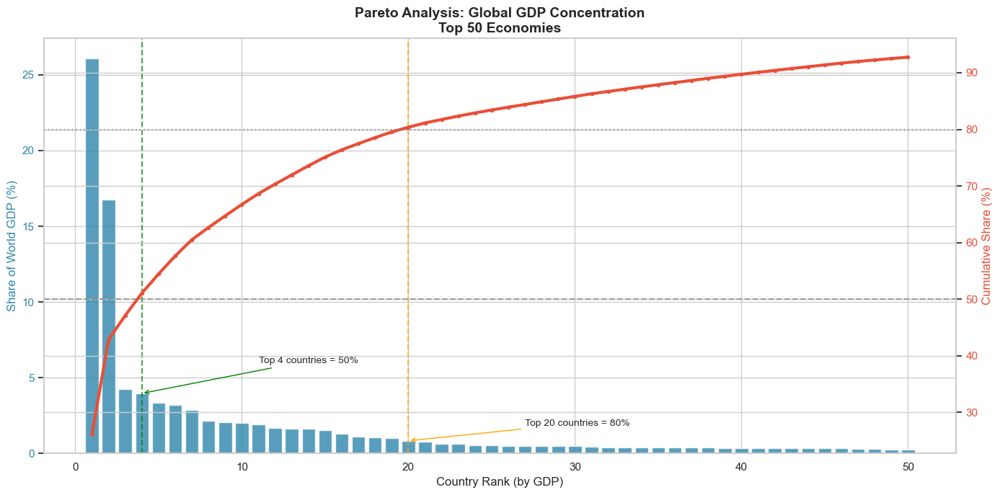


Figure 15: Pareto analysis of global GDP distribution.
Key finding: The top 4 economies represent 50% of world GDP.
The top 20 economies represent 80% of world GDP.


In [27]:
# Pareto chart: GDP concentration analysis
df_sorted = df_analysis.sort_values('GDP_Trillion', ascending=False).reset_index(drop=True)
df_sorted['Cumulative_GDP_Share'] = df_sorted['World_GDP_Share'].cumsum()
df_sorted['Country_Rank'] = range(1, len(df_sorted) + 1)

fig, ax1 = plt.subplots(figsize=(14, 7))

# Bar chart for individual GDP share
bars = ax1.bar(df_sorted['Country_Rank'][:50], df_sorted['World_GDP_Share'][:50], 
               color='#2E86AB', alpha=0.8, edgecolor='white', label='Individual Share')
ax1.set_xlabel('Country Rank (by GDP)', fontsize=12)
ax1.set_ylabel('Share of World GDP (%)', color='#2E86AB', fontsize=12)
ax1.tick_params(axis='y', labelcolor='#2E86AB')

# Line chart for cumulative share
ax2 = ax1.twinx()
ax2.plot(df_sorted['Country_Rank'][:50], df_sorted['Cumulative_GDP_Share'][:50], 
         color='#E94F37', linewidth=3, marker='o', markersize=3, label='Cumulative Share')
ax2.set_ylabel('Cumulative Share (%)', color='#E94F37', fontsize=12)
ax2.tick_params(axis='y', labelcolor='#E94F37')

# Add reference lines
ax2.axhline(y=50, color='gray', linestyle='--', alpha=0.7, label='50% line')
ax2.axhline(y=80, color='gray', linestyle=':', alpha=0.7, label='80% line')

# Find where cumulative reaches 50% and 80%
idx_50 = (df_sorted['Cumulative_GDP_Share'] >= 50).idxmax()
idx_80 = (df_sorted['Cumulative_GDP_Share'] >= 80).idxmax()

ax1.axvline(x=idx_50+1, color='green', linestyle='--', alpha=0.7)
ax1.axvline(x=idx_80+1, color='orange', linestyle='--', alpha=0.7)

plt.title('Pareto Analysis: Global GDP Concentration\nTop 50 Economies', fontsize=14, fontweight='bold')

# Add annotations
ax1.annotate(f'Top {idx_50+1} countries = 50%', xy=(idx_50+1, df_sorted.loc[idx_50, 'World_GDP_Share']),
             xytext=(idx_50+8, df_sorted.loc[idx_50, 'World_GDP_Share']+2),
             fontsize=10, arrowprops=dict(arrowstyle='->', color='green'))

ax1.annotate(f'Top {idx_80+1} countries = 80%', xy=(idx_80+1, df_sorted.loc[idx_80, 'World_GDP_Share']),
             xytext=(idx_80+8, df_sorted.loc[idx_80, 'World_GDP_Share']+1),
             fontsize=10, arrowprops=dict(arrowstyle='->', color='orange'))

fig.tight_layout()
plt.show()

print(f"\nFigure 15: Pareto analysis of global GDP distribution.")
print(f"Key finding: The top {idx_50+1} economies represent 50% of world GDP.")
print(f"The top {idx_80+1} economies represent 80% of world GDP.")

### 8.2 GDP Growth Categories: Comparative Analysis

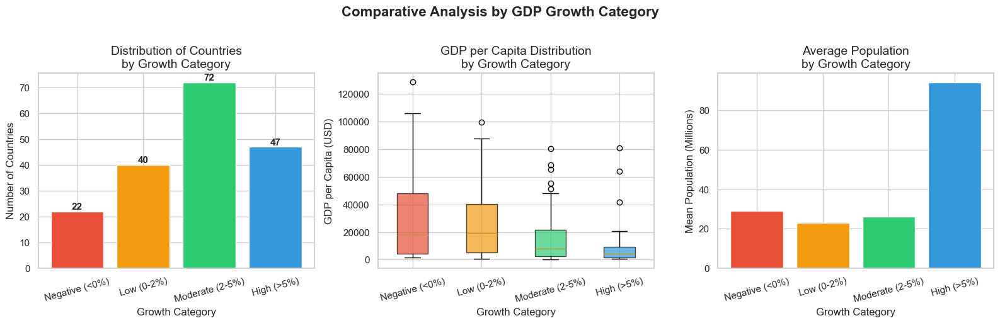


Figure 16: Comparative analysis showing how growth categories differ in composition and characteristics.


In [28]:
# Categorize countries by GDP growth
def categorize_growth(growth):
    if pd.isna(growth):
        return 'Unknown'
    elif growth < 0:
        return 'Negative (<0%)'
    elif growth < 2:
        return 'Low (0-2%)'
    elif growth < 5:
        return 'Moderate (2-5%)'
    else:
        return 'High (>5%)'

df_analysis['Growth_Category'] = df_analysis['GDP_Growth_Pct'].apply(categorize_growth)

# Create comparative visualization
fig, axes = plt.subplots(1, 3, figsize=(16, 5))
fig.suptitle('Comparative Analysis by GDP Growth Category', fontsize=16, fontweight='bold', y=1.02)

# Define order and colors
category_order = ['Negative (<0%)', 'Low (0-2%)', 'Moderate (2-5%)', 'High (>5%)']
category_colors = {'Negative (<0%)': '#E94F37', 'Low (0-2%)': '#F39C12', 
                   'Moderate (2-5%)': '#2ECC71', 'High (>5%)': '#3498DB'}

# Filter out Unknown category
df_growth = df_analysis[df_analysis['Growth_Category'] != 'Unknown'].copy()

# 1. Count by category
ax1 = axes[0]
counts = df_growth['Growth_Category'].value_counts().reindex(category_order)
bars = ax1.bar(category_order, counts, color=[category_colors[c] for c in category_order], edgecolor='white')
ax1.set_xlabel('Growth Category')
ax1.set_ylabel('Number of Countries')
ax1.set_title('Distribution of Countries\nby Growth Category')
ax1.tick_params(axis='x', rotation=15)

# Add count labels
for bar, count in zip(bars, counts):
    ax1.annotate(f'{int(count)}', xy=(bar.get_x() + bar.get_width()/2, bar.get_height()),
                 ha='center', va='bottom', fontsize=11, fontweight='bold')

# 2. Box plot of GDP per Capita by category
ax2 = axes[1]
box_data = [df_growth[df_growth['Growth_Category'] == cat]['GDP_Per_Capita'].dropna() for cat in category_order]
bp = ax2.boxplot(box_data, labels=category_order, patch_artist=True)
for patch, cat in zip(bp['boxes'], category_order):
    patch.set_facecolor(category_colors[cat])
    patch.set_alpha(0.7)
ax2.set_xlabel('Growth Category')
ax2.set_ylabel('GDP per Capita (USD)')
ax2.set_title('GDP per Capita Distribution\nby Growth Category')
ax2.tick_params(axis='x', rotation=15)

# 3. Mean population by category
ax3 = axes[2]
mean_pop = df_growth.groupby('Growth_Category')['Population_Millions'].mean().reindex(category_order)
bars = ax3.bar(category_order, mean_pop, color=[category_colors[c] for c in category_order], edgecolor='white')
ax3.set_xlabel('Growth Category')
ax3.set_ylabel('Mean Population (Millions)')
ax3.set_title('Average Population\nby Growth Category')
ax3.tick_params(axis='x', rotation=15)

plt.tight_layout()
plt.show()

print("\nFigure 16: Comparative analysis showing how growth categories differ in composition and characteristics.")

### 8.3 Outlier Analysis

In [29]:
# Identify outliers using IQR method
def identify_outliers_iqr(data, column):
    """Identify outliers using the IQR method (1.5 × IQR rule)."""
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = data[(data[column] < lower_bound) | (data[column] > upper_bound)]
    return outliers, lower_bound, upper_bound

growth_outliers, lb, ub = identify_outliers_iqr(df_analysis, 'GDP_Growth_Pct')

print("OUTLIER ANALYSIS: GDP GROWTH")
print("="*70)
print(f"IQR Method: Lower bound = {lb:.2f}%, Upper bound = {ub:.2f}%")
print(f"Number of outliers: {len(growth_outliers)}")
print("\nOutlier countries:")
print(growth_outliers[['Country', 'GDP_Growth_Pct', 'GDP_Per_Capita', 'Income_Group']].sort_values('GDP_Growth_Pct').to_string(index=False))

OUTLIER ANALYSIS: GDP GROWTH
IQR Method: Lower bound = -4.59%, Upper bound = 10.82%
Number of outliers: 7

Outlier countries:
           Country  GDP_Growth_Pct  GDP_Per_Capita Income_Group
             Sudan          -20.11          2183.0 Lower-Middle
       Timor-Leste          -18.12          1503.0 Lower-Middle
           Ireland           -5.53        106106.0  High Income
State of Palestine           -5.41          3221.0 Lower-Middle
 Equatorial Guinea           -5.09          6678.0 Upper-Middle
            Guyana           33.80         20765.0  High Income
             Macao           75.06         64158.0  High Income


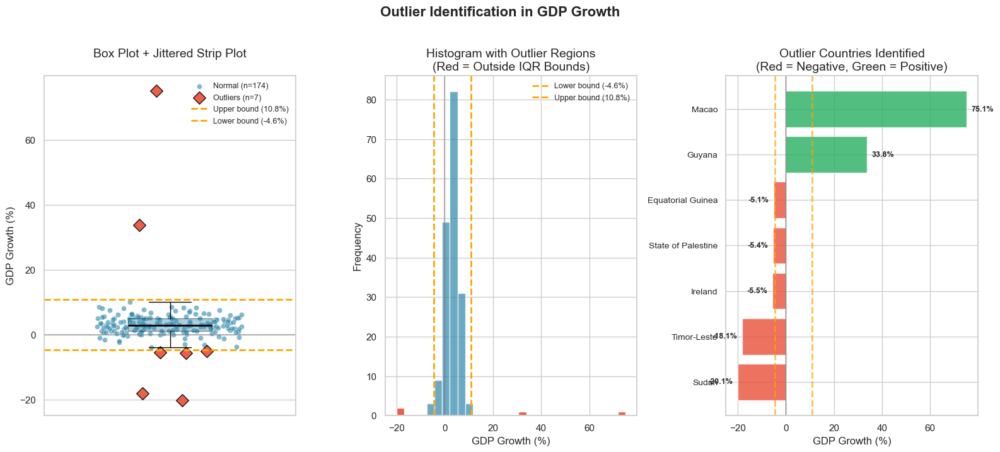


Figure 17: Outlier visualization with three complementary views:
- Left: Jittered strip plot overlaid on box plot for clear point distribution
- Center: Histogram with outlier regions highlighted in red
- Right: Labeled bar chart identifying specific outlier countries


In [32]:
# Create outlier visualization 
fig, axes = plt.subplots(1, 3, figsize=(16, 7))
fig.suptitle('Outlier Identification in GDP Growth', fontsize=16, fontweight='bold', y=1.02)

# Prepare data
df_outlier_viz = df_analysis[['Country', 'GDP_Growth_Pct', 'GDP_Per_Capita', 'Income_Group']].dropna().copy()
df_outlier_viz['Is_Outlier'] = df_outlier_viz['GDP_Growth_Pct'].apply(
    lambda x: 'Outlier' if (x < lb or x > ub) else 'Normal'
)

# 1. Combined Box Plot + Swarm Plot 
ax1 = axes[0]
# Create box plot
bp = ax1.boxplot(df_outlier_viz['GDP_Growth_Pct'], positions=[0], widths=0.4, patch_artist=True,
                 boxprops=dict(facecolor='#2E86AB', alpha=0.4),
                 medianprops=dict(color='black', linewidth=2),
                 flierprops=dict(marker='', markersize=0))  # Hide default outlier markers

# Add swarm-style jittered points 
np.random.seed(42)  # For reproducibility
normal_data = df_outlier_viz[df_outlier_viz['Is_Outlier'] == 'Normal']
outlier_data = df_outlier_viz[df_outlier_viz['Is_Outlier'] == 'Outlier']

# Jitter function that spreads points based on local density
def density_jitter(y_values, spread=0.3):
    """Create jittered x positions based on local density."""
    n = len(y_values)
    # Sort by y value and assign x positions that spread nearby values
    sorted_indices = np.argsort(y_values)
    x_positions = np.zeros(n)
    for i, idx in enumerate(sorted_indices):
        # Alternate left and right to create visual spread
        x_positions[idx] = spread * (np.random.random() - 0.5) * 2
    return x_positions

# Plot normal points with density-based jitter
normal_jitter = density_jitter(normal_data['GDP_Growth_Pct'].values, spread=0.35)
ax1.scatter(normal_jitter, normal_data['GDP_Growth_Pct'], 
            alpha=0.6, s=35, c='#2E86AB', edgecolors='white', linewidth=0.5,
            label=f'Normal (n={len(normal_data)})')

# Plot outliers with distinct markers
outlier_jitter = density_jitter(outlier_data['GDP_Growth_Pct'].values, spread=0.2)
ax1.scatter(outlier_jitter, outlier_data['GDP_Growth_Pct'], 
            alpha=0.9, s=100, c='#E94F37', marker='D', edgecolors='black', linewidth=1,
            label=f'Outliers (n={len(outlier_data)})')

# Add outlier bounds
ax1.axhline(y=ub, color='orange', linestyle='--', linewidth=2, label=f'Upper bound ({ub:.1f}%)')
ax1.axhline(y=lb, color='orange', linestyle='--', linewidth=2, label=f'Lower bound ({lb:.1f}%)')
ax1.axhline(y=0, color='gray', linestyle='-', alpha=0.5)

ax1.set_xlim(-0.6, 0.6)
ax1.set_ylabel('GDP Growth (%)', fontsize=12)
ax1.set_title('Box Plot + Jittered Strip Plot\n')
ax1.set_xticks([])
ax1.legend(loc='upper right', fontsize=9)

# 2. Histogram with Outlier Regions Highlighted
ax2 = axes[1]
all_growth = df_outlier_viz['GDP_Growth_Pct']

# Plot histogram
n, bins, patches = ax2.hist(all_growth, bins=30, color='#2E86AB', edgecolor='white', alpha=0.7)

# Color outlier regions
for patch, left_edge, right_edge in zip(patches, bins[:-1], bins[1:]):
    if right_edge <= lb or left_edge >= ub:
        patch.set_facecolor('#E94F37')
        patch.set_alpha(0.9)

ax2.axvline(x=lb, color='orange', linestyle='--', linewidth=2, label=f'Lower bound ({lb:.1f}%)')
ax2.axvline(x=ub, color='orange', linestyle='--', linewidth=2, label=f'Upper bound ({ub:.1f}%)')
ax2.axvline(x=0, color='gray', linestyle='-', alpha=0.5)

ax2.set_xlabel('GDP Growth (%)', fontsize=12)
ax2.set_ylabel('Frequency', fontsize=12)
ax2.set_title('Histogram with Outlier Regions\n(Red = Outside IQR Bounds)')
ax2.legend(loc='upper right', fontsize=9)

# 3. Labeled Outlier Chart
ax3 = axes[2]

# Sort outliers by GDP Growth for better visualization
outliers_sorted = outlier_data.sort_values('GDP_Growth_Pct')

# Create horizontal bar chart for outliers
colors = ['#E94F37' if x < 0 else '#27AE60' for x in outliers_sorted['GDP_Growth_Pct']]
bars = ax3.barh(range(len(outliers_sorted)), outliers_sorted['GDP_Growth_Pct'], 
                color=colors, edgecolor='white', alpha=0.8)

ax3.set_yticks(range(len(outliers_sorted)))
ax3.set_yticklabels(outliers_sorted['Country'], fontsize=10)
ax3.axvline(x=0, color='gray', linestyle='-', linewidth=1)
ax3.axvline(x=lb, color='orange', linestyle='--', linewidth=2, alpha=0.7)
ax3.axvline(x=ub, color='orange', linestyle='--', linewidth=2, alpha=0.7)

# Add value labels
for i, (idx, row) in enumerate(outliers_sorted.iterrows()):
    offset = 2 if row['GDP_Growth_Pct'] >= 0 else -2
    ha = 'left' if row['GDP_Growth_Pct'] >= 0 else 'right'
    ax3.annotate(f"{row['GDP_Growth_Pct']:.1f}%", 
                 xy=(row['GDP_Growth_Pct'] + offset, i),
                 va='center', ha=ha, fontsize=9, fontweight='bold')

ax3.set_xlabel('GDP Growth (%)', fontsize=12)
ax3.set_title('Outlier Countries Identified\n(Red = Negative, Green = Positive)')

plt.tight_layout()
plt.show()

print("\nFigure 17: Outlier visualization with three complementary views:")
print("- Left: Jittered strip plot overlaid on box plot for clear point distribution")
print("- Center: Histogram with outlier regions highlighted in red")
print("- Right: Labeled bar chart identifying specific outlier countries")

---

## 9. Conclusions and Recommendations

### 9.1 Summary of Key Findings

This exploratory data analysis of the Global GDP Dataset 2023 has revealed several important patterns:

1. **Extreme Concentration of Global GDP**: The top 4 economies (USA, China, Germany, Japan) account for approximately 50% of world GDP. This follows a Pareto-like pattern where roughly 20 countries control about 80% of global economic output.

2. **Right-Skewed Distributions**: GDP, population, and GDP per capita all exhibit strong right-skewness, as evidenced by the large differences between mean and median values. Log transformation reveals more interpretable patterns.

3. **Strong GDP-Population Correlation**: There is a significant positive correlation (r ≈ 0.79) between log-transformed GDP and population, confirming that larger countries tend to have larger economies.

4. **Development-Growth Relationship**: High-income countries show lower average GDP growth rates compared to developing economies, consistent with convergence theory in economic development.

5. **Global Inequality**: High-income countries (about 35% of countries) account for approximately 75% of world GDP while representing a smaller fraction of global population.

6. **Geographic Patterns**: The world maps reveal regional clustering of economic development, with high-income countries concentrated in North America, Western Europe, and Oceania, while high-growth economies are predominantly in Africa and Asia.

In [31]:
# Generate final summary statistics table
print("FINAL SUMMARY: KEY STATISTICS")
print("="*70)

summary_final = {
    'Metric': ['Total Countries', 'Total World GDP (Est.)', 'Median GDP', 'Mean GDP',
               'Highest GDP Country', 'Lowest GDP Country', 'Median GDP per Capita',
               'Highest GDP per Capita', 'Lowest GDP per Capita', 'Mean GDP Growth',
               'Countries with Negative Growth'],
    'Value': [
        f"{len(df_analysis)}",
        f"${df_analysis['GDP_Trillion'].sum():.2f} Trillion",
        f"${df_analysis['GDP_Trillion'].median()*1000:.1f} Billion",
        f"${df_analysis['GDP_Trillion'].mean()*1000:.1f} Billion",
        f"{df_analysis.loc[df_analysis['GDP_Trillion'].idxmax(), 'Country']} (${df_analysis['GDP_Trillion'].max():.2f}T)",
        f"{df_analysis.loc[df_analysis['GDP_Trillion'].idxmin(), 'Country']} (${df_analysis['GDP_Trillion'].min()*1e6:.1f}M)",
        f"${df_analysis['GDP_Per_Capita'].median():,.0f}",
        f"{df_analysis.loc[df_analysis['GDP_Per_Capita'].idxmax(), 'Country']} (${df_analysis['GDP_Per_Capita'].max():,.0f})",
        f"{df_analysis.loc[df_analysis['GDP_Per_Capita'].idxmin(), 'Country']} (${df_analysis['GDP_Per_Capita'].min():,.0f})",
        f"{df_analysis['GDP_Growth_Pct'].mean():.2f}%",
        f"{(df_analysis['GDP_Growth_Pct'] < 0).sum()}"
    ]
}

summary_df = pd.DataFrame(summary_final)
print(summary_df.to_string(index=False))

FINAL SUMMARY: KEY STATISTICS
                        Metric                   Value
               Total Countries                     181
        Total World GDP (Est.)        $104.57 Trillion
                    Median GDP           $48.5 Billion
                      Mean GDP          $577.8 Billion
           Highest GDP Country United States ($27.72T)
            Lowest GDP Country         Tuvalu ($62.3M)
         Median GDP per Capita                  $7,182
        Highest GDP per Capita   Luxembourg ($128,936)
         Lowest GDP per Capita          Burundi ($193)
               Mean GDP Growth                   3.28%
Countries with Negative Growth                      22


### 9.2 Methodological Reflection

This analysis applied key EDA techniques from the course literature:

- **Tukey's EDA Framework (1977)**: The iterative, visual exploration approach helped identify patterns that would be missed by purely numerical analysis.

- **Design Principles (Knaflic, 2015)**: Visualizations were designed to minimize clutter, use appropriate color encoding, and highlight the most important findings. The principle of "separating signal from noise" guided our decluttering decisions.

- **Statistical Rigor (Bruce et al., 2020)**: Proper calculation and interpretation of location, variability, and correlation metrics ensured reliable insights.

- **Interactive Visualization (Plotly)**: Interactive charts complement static visualizations by enabling user-driven exploration and detailed inspection of individual data points.

- **Geographic Context**: World maps provided crucial spatial perspective that revealed regional clustering patterns not visible in traditional charts.

### 9.3 Recommendations for Further Analysis

1. **Time Series Analysis**: Incorporating historical data would enable trend analysis and forecasting.

2. **Clustering Analysis**: Machine learning techniques could identify natural groupings of similar economies.

3. **Additional Variables**: Including factors like trade balance, inflation, education metrics, and industry composition would provide deeper economic insights.

4. **Regional Deep-Dives**: Focused analysis on specific regions (e.g., European Union, ASEAN) could reveal intra-regional patterns.

---

## References

- Bruce, A., Bruce, P., & Gedeck, P. (2020). *Practical Statistics for Data Scientists* (2nd ed.). O'Reilly Media.
- Knaflic, C. N. (2015). *Storytelling with Data: A Data Visualization Guide for Business Professionals*. Wiley.
- Wilke, C. O. (2019). *Fundamentals of Data Visualization*. O'Reilly Media.
- IU International University. (2023). *Course Book: Explorative Data Analysis and Visualization*.
- Grobmann, T., & Dobler, M. (2019). *Data Visualization with Python*. Packt Publishing.

---

**Data Source**: (https://www.kaggle.com/datasets/asadullahcreative/global-gdp-explorer-2024-world-bank-un-data)